<a href="https://colab.research.google.com/github/azhang4216/Amazon_NN/blob/main/extra_credit.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Grocery Review Analysis - Extra Credit

Group Project by: Pape S. Traore, Angela Zhang, Taylor Olson, Sabrina Jain
Extra Credit by: Angela Zhang

CS74, Fall 2020, Professor V.S. Subrahmanian

Note: We transitioned to Google Colab for the final deliverable as we increased the size of our TFIDF vectors five-fold. As such, our path names for loading the data are localized and will likely need to be modified to run correctly. The only other modification to allow this notebook to run in its entirety is to include (at the same level as the notebook) the varSentiment directory included in our submitted zip file.

## Import Libraries and Modules

In [ ]:
import pandas as pd
import numpy as np
from scipy import stats
import re
import pickle
import math
import matplotlib.pyplot as plt
from joblib import dump, load
from collections import Counter
import json

#nltk library
import nltk 
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer

# sklearn library
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.metrics import f1_score, roc_auc_score, accuracy_score
from sklearn.model_selection import train_test_split, cross_val_score, cross_validate
from sklearn.naive_bayes import GaussianNB, MultinomialNB
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import LinearSVC, SVC
from sklearn.linear_model import LogisticRegression
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.preprocessing import StandardScaler, MinMaxScaler, normalize
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import RandomizedSearchCV, GridSearchCV
from sklearn.model_selection import KFold, StratifiedKFold
from sklearn.ensemble import VotingClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.preprocessing import StandardScaler, MinMaxScaler, Normalizer
from sklearn.decomposition import PCA
from sklearn.pipeline import Pipeline
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import FeatureUnion

# imblearn library (for oversampling)
from imblearn.pipeline import Pipeline, make_pipeline
from imblearn.over_sampling import SMOTE
#from imblearn.over_sampling import SVMSMOTE, SMOTENC, ADASYN, BorderlineSMOTE (no longer used)

# seaborn library (for correlation heat map)
import seaborn as sns

/usr/local/lib/python3.6/dist-packages/sklearn/externals/six.py:31: FutureWarning: The module is deprecated in version 0.21 and will be removed in version 0.23 since we've dropped support for Python 2.7. Please rely on the official version of six (https://pypi.org/project/six/).
  "(https://pypi.org/project/six/).", FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:144: FutureWarning: The sklearn.neighbors.base module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.neighbors. Anything that cannot be imported from sklearn.neighbors is now part of the private API.
  warnings.warn(message, FutureWarning)


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


## Data Preprocessing (Pre-Made Tables Included w/ Submission)

### Table Formatting + Feature Creation


In [ ]:
from vaderSentiment import SentimentIntensityAnalyzer
# calculate sentiment scores
def calculate_sentiment_intensities(reviews):
    scores = []
    analyzer = SentimentIntensityAnalyzer()
    for sentence in reviews:
        vs = analyzer.polarity_scores(sentence)
        scores.append([vs['neg'],vs['neu'],vs['pos'],vs['compound']])
    return scores

data = pd.read_json('./data2/Grocery_and_Gourmet_Food_Reviews_training.json',lines=1).sort_values(by='asin') # modify with your own path
predictions = pd.read_json('./data2/Grocery_and_Gourmet_Food_Reviews_test.json',lines=1)

# replaced NaN with empty string
data_noNaN = data[['asin','overall','verified','unixReviewTime','reviewerName','reviewText','summary']].fillna('')
pred_noNaN = predictions[['asin','verified','unixReviewTime','reviewerName','reviewText','summary']].fillna('')

# chose desired features
data_desired_features = data_noNaN[['asin','verified','summary','reviewText','overall']]
pred_desired_features = pred_noNaN[['asin','verified','summary','reviewText']]

# New feature: Number of reviews per product
data_desired_features['numOfReviews'] = np.array(data.groupby('asin').size())
pred_desired_features['numOfReviews'] = np.array(predictions.groupby('asin').size())

# New feature: Range review time for each product
min_max_table = data.groupby('asin').agg({"unixReviewTime":[np.max,np.min]}).reset_index()
reviewTimeRange = min_max_table['unixReviewTime']['amax'] - min_max_table['unixReviewTime']['amin']
data_desired_features['reviewTimeRange'] = reviewTimeRange
min_max_table = predictions.groupby('asin').agg({"unixReviewTime":[np.max,np.min]}).reset_index()
reviewTimeRange = min_max_table['unixReviewTime']['amax'] - min_max_table['unixReviewTime']['amin']
pred_desired_features['reviewTimeRange'] = reviewTimeRange

# Number of verified reviews
s = data.groupby('asin').agg({'verified':Counter}).reset_index()
verifiedList = []
for verified in verified_column:
    verifiedList.append(verified[1]/(verified[1]+verified[0]))
data_desired_features['percentageOfVerified'] = verifiedList
s = predictions.groupby('asin').agg({'verified':Counter}).reset_index()
verifiedList = []
for verified in verified_column:
    verifiedList.append(verified[1]/(verified[1]+verified[0]))
data_desired_features['percentageOfVerified'] = verifiedList

# group by asin number (same product) and find average rating and combine text
data_by_product = data_desired_features.groupby('asin').agg({'overall':np.mean,'reviewText': ' '.join,'summary': ' '.join})
data_by_product['class'] = data_by_product['overall'].apply(lambda val: 1 if val > 4.4 else 0)
data_by_product = data_by_product.reset_index()
pred_by_product = pred_desired_features.groupby('asin').agg({'reviewText': ' '.join,'summary': ' '.join})
pred_by_product = pred_by_product.reset_index()

# calculate sentiment scores for summaries
summaries = data_by_product.summary
sentiments_scores = calculate_sentiment_intensities(summaries)
sentiments_table = pd.DataFrame(sentiments_scores,columns=['negative','neutral','positive','compound'])
sentiments_table['asin'] = (pd.Series(data_by_product['asin'])).values
summaries_pred = pred_by_product.summary
pred_sentiments_scores = calculate_sentiment_intensities(summaries_pred)
pred_sentiments_table = pd.DataFrame(pred_sentiments_scores,columns=['negative','neutral','positive','compound'])
pred_sentiments_table['asin'] = (pd.Series(pred_by_product['asin'])).values

# add sentiment scores to main table
data_sentiments = pd.concat([data_by_product,sentiments_table],axis=1)
pred_sentiments = pd.concat([pred_by_product,pred_sentiments_table],axis=1)

# remove duplicate columns
data_no_duplicates = data_sentiments.loc[:,~data_sentiments.columns.duplicated()].drop(labels=['asin'],axis=1)
pred_no_duplicates = pred_sentiments.loc[:,~pred_sentiments.columns.duplicated()].drop(labels=['asin'],axis=1)

# combine summary and review text into a single extra column
data_combined = data_no_duplicates
data_combined['reviewText_summary'] = pd.Series(data_combined['reviewText']) + " " + pd.Series(data_combined['summary'])
pred_combined = pred_no_duplicates
pred_combined['reviewText_summary'] = pd.Series(pred_combined['reviewText']) + " " + pd.Series(pred_combined['summary'])

# Number of words per product 
data_combined['numOfwords'] = data_combined['reviewText_summary'].apply(len)
pred_combined['numOfwords'] = pred_combined['reviewText_summary'].apply(len)

# Misspelled words
from spellchecker import SpellChecker
from nltk.tokenize import word_tokenize
spell = SpellChecker()

texts = data_combined['reviewText_summary']
misspelledWordCountArray = []
for text in texts:
    percentage = len(spell.unknown(word_tokenize(text))) / len(text)
    misspelledWordCountArray.append(percentage)
data_combined['numOfMisspelledWords'] = misspelledWordCountArray

texts = pred_combined['reviewText_summary']
misspelledWordCountArray = []
for text in texts:
    percentage = len(spell.unknown(word_tokenize(text))) / len(text)
    misspelledWordCountArray.append(percentage)
pred_combined['numOfMisspelledWords'] = misspelledWordCountArray

# save table
data_combined.to_json('./training_data.json')
pred_combined.to_json('./testing_data.json')

SyntaxError: ignored

### Text Formatting and Cleanup (NOTE: Don't run if using files on Google Drive)

In [ ]:
# remove punctation in text
def remove_noise(text):
    return re.sub(r'[\.\?\!\,\:\;\&\-\<\>\=\$\)\(\\/\d\*\\"]', '', text)

# read data back in that was processed in the table formatting section above
data = pd.read_json('./training_data.json') # PATH NOTE (check to make sure your path is correct)
data_text = data[['asin','reviewText','summary','reviewText_summary']]
pred = pd.read_json('./testing_data.json') # PATH NOTE (check to make sure your path is correct)
pred_text = pred[['asin','reviewText','summary','reviewText_summary']]

# remove noise from all text
reviewText_summary = data_text['reviewText_summary'].apply(remove_noise)
summary = data_text['summary'].apply(remove_noise)
reviewText = data_text['reviewText'].apply(remove_noise)
pred_reviewText_summary = pred_text['reviewText_summary'].apply(remove_noise)
pred_summary = pred_text['summary'].apply(remove_noise)
pred_reviewText = pred_text['reviewText'].apply(remove_noise)

# put the processed text back into the dataframe
data['reviewText_summary'] = pd.Series(reviewText_summary)
data['summary'] = pd.Series(summary)
data['reviewText'] = pd.Series(reviewText)
pred['reviewText_summary'] = pd.Series(pred_reviewText_summary)
pred['summary'] = pd.Series(pred_summary)
pred['reviewText'] = pd.Series(pred_reviewText)

# save table
data.to_json('./training_data.json')
pred.to_json('./testing_data.json')

## Neural Network (Extra Credit)

In [5]:
# imports for NN
from keras.models import Sequential
from keras import layers
import talos
talos.__version__

ModuleNotFoundError: ignored

In [ ]:
def compute_tfidf(table):
  text = table.text
  vectorizer = TfidfVectorizer(stop_words = "english" , token_pattern='[A-Za-z][\w\-]*',max_features=2000, ngram_range=(1,2))
  vectors = vectorizer.fit_transform(text)
  feature_names = vectorizer.get_feature_names()
  dense = vectors.todense()
  denselist = dense.tolist()
  tfidf = pd.DataFrame(denselist, columns=feature_names)
  tfidf['class'] = table['class']
  return tfidf 

In [ ]:
def amazon_food_nn_model(X_train, X_test, y_train, y_test, params):
  # build basic model to start
  input_dim = X_train.shape[1]  # Number of features
  model = Sequential()
  model.add(layers.Dense(10, input_dim=input_dim, activation='relu'))

  # now we test for number of layers and shapes
  hidden_layers(model, params, 1)

  model.add(layers.Dense(1, activation=params['last_activation'], kernel_initializer='normal'))
  model.compile(loss=params['losses'],
                # Talos regulizer normalization function
                optimizer=params['optimizer'](lr=lr_normalizer(params['lr'],params['optimizer'])),
                # f1_m is our custom f1_macro metric
                metrics=[[f1_m], fmeasure])
  
  history = model.fit(X_train, y_train, 
                        batch_size=params['batch_size'],
                        epochs=params['epochs'],
                        verbose=0)
  
  return history, model

In [ ]:
# parameter space for hypertuning
params = {'lr': (0.5, 5, 10),
          'first_neuron':[4, 8, 16, 32, 64],
          'hidden_layers':[0, 1, 2],
          'batch_size': (2, 30, 10),
          'epochs': [150],
          'dropout': (0, 0.5, 5),
          'weight_regulizer':[None],
          'emb_output_dims': [None],
          'shape':['brick','long_funnel'],
          'optimizer': [Adam, Nadam, RMSprop],
          'losses': [logcosh, binary_crossentropy],
          'activation':[relu, elu],
          'last_activation': [sigmoid]}

In [ ]:
# Create TF-IDF Table
data = pd.read_json('/content/drive/My Drive/training_data.json').fillna("") # import data (PATH NOTE)
text_data = data[['text','class']].rename(columns={'reviewText_summary':'text'}) # table with combined review+summary text per feature
tfidf = compute_tfidf(text_data)

In [ ]:
X = tfidf.drop(columns=['class'])
y = tfidf['class']

In [ ]:
# EXTRA CREDIT - splitting data for neural network
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=1000)

In [ ]:
X_train

,able,absolute,absolutely,absolutely delicious,absolutely love,according,acid,acidic,actual,actually,add,add little,added,added sugar,addicted,addicting,addictive,adding,addition,additional,additives,adds,admit,advertised,affordable,afternoon,aftertaste,agave,ago,agree,air,alcohol,allergic,allergies,almond,almond butter,almond milk,almonds,alot,alternative,...,wonderful flavor,wonderfully,word,work,worked,working,works,works great,world,worry,worse,worst,worth,worth price,wouldn,wouldn t,wow,wrap,wrapped,write,wrong,x,xylitol,yeah,year,year old,years,years ago,yeast,yellow,yes,yogurt,yuck,yum,yum stars,yum yum,yummy,yummy great,yummy stars,zero
27072,0.0,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.025294,0.0,0.000000,0.0,0.045165,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.082852,0.047677,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.035948,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.047142,0.0,0.029164,0.0,0.0,0.000000,0.0,0.0,0.0
357,0.0,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
28894,0.0,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.054182,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.041517,0.0,0.000000,0.046070,0.065146,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.027347,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
20012,0.0,0.166823,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
21895,0.0,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.007343,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.013147,0.000000,0.0,0.0,0.000000,0.0,0.000000,...,0.0,0.0,0.0,0.007169,0.0,0.000000,0.007955,0.011249,0.000000,0.000000,0.0,0.011623,0.006810,0.000000,0.000000,0.000000,0.009444,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.01251,0.0,0.000000,0.0,0.000000,0.0,0.0,0.055008,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
32189,0.0,0.000000,0.00000,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.000000,0.0,0.049562,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.080563,0.000000,0.0,0.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.062088,...,0.0,0.0,0.0,0.000000,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.045960,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.0,0.000000,0.0,0.0,0.00000,0.0,0.000000,0.0,0.000000,0.0,0.0,0.000000,0.0,0.0,0.0
18782,0.0,0.000000,0.00000,0.0,0.

In [ ]:
# neural networks
from keras.models import Sequential
from keras import layers

input_dim = X_train.shape[1]  # Number of features

model = Sequential()
model.add(layers.Dense(10, input_dim=input_dim, activation='relu'))
model.add(layers.Dense(4, activation='relu'))
model.add(layers.Dense(1, activation='sigmoid'))

In [ ]:
model.compile(loss='binary_crossentropy', optimizer='adam', metrics=[f1_m])
model.summary()

Model: "sequential_5"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense_11 (Dense)             (None, 10)                20010     
_________________________________________________________________
dense_12 (Dense)             (None, 4)                 44        
_________________________________________________________________
dense_13 (Dense)             (None, 1)                 5         
Total params: 20,059
Trainable params: 20,059
Non-trainable params: 0
_________________________________________________________________


In [ ]:
history = model.fit(X_train, y_train, epochs=10, batch_size=10)

Epoch 1/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.5022 - f1_m: 0.7858
Epoch 2/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.4226 - f1_m: 0.8139
Epoch 3/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.4108 - f1_m: 0.8204
Epoch 4/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.4039 - f1_m: 0.8245
Epoch 5/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.3982 - f1_m: 0.8258
Epoch 6/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.3913 - f1_m: 0.8287
Epoch 7/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.3823 - f1_m: 0.8368
Epoch 8/10
2480/2480 [==============================] - 3s 1ms/step - loss: 0.3712 - f1_m: 0.8389
Epoch 9/10
2480/2480 [==============================] - 4s 1ms/step - loss: 0.3571 - f1_m: 0.8464
Epoch 10/10
2480/2480 [==============================] - 4s 1ms/step - loss: 0.3436 - f1_m: 0.8538


In [ ]:
print(model.evaluate(X_test, y_test))
model.metrics_names

259/259 [==============================] - 0s 1ms/step - loss: 0.4756 - f1_m: 0.8138
[0.47557422518730164, 0.8138307929039001]


['loss', 'f1_m']

In [ ]:
# https://datascience.stackexchange.com/questions/45165/how-to-get-accuracy-f1-precision-and-recall-for-a-keras-model
from keras import backend as K

def recall_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    possible_positives = K.sum(K.round(K.clip(y_true, 0, 1)))
    recall = true_positives / (possible_positives + K.epsilon())
    return recall

def precision_m(y_true, y_pred):
    true_positives = K.sum(K.round(K.clip(y_true * y_pred, 0, 1)))
    predicted_positives = K.sum(K.round(K.clip(y_pred, 0, 1)))
    precision = true_positives / (predicted_positives + K.epsilon())
    return precision

def f1_m(y_true, y_pred):
    precision = precision_m(y_true, y_pred)
    recall = recall_m(y_true, y_pred)
    return 2*((precision*recall)/(precision+recall+K.epsilon()))

## Final Hypertuning and Ensemble Testing

#### Create dataset

In [ ]:
# # Add extra features
# X['negative2'] = data['negative']
# X['positive2'] = data['positive'].apply(lambda x: x * -1)
# X['mispelledWords'] = data['numOfMisspelledWords']
# X['percentageOfVerified'] = data['percentageOfVerified'].apply(lambda x: x * -0.5)

#### Functions

In [ ]:
"""
Create table of tf-idf vectors

inputs: 
  - passed_data: text to be vectorized
  - numFeatures: maximum number of tfidf features to include
  - ngram_max: maximum n-gram to be included
  - remove_neg_stopwords: if True, negative stopwords will be included
  - save_vectorizer: if True, tfidf vectorizer will be dumped & saved to 'vectorizer.pickle'
outputs:
  - tfidf_table: table of all tf-idf vectors
"""
def get_tfidf_table(passed_data, numFeatures, ngram_max, remove_neg_stopwords=True, save_vectorizer=True):
    if 'text' in passed_data.columns: # check to make sure text is passed in
        text =  np.array(passed_data.text)
        stop = get_stopwords()
        vectorizer = TfidfVectorizer(max_df=.9,min_df=3,norm='l2', token_pattern='[A-Za-z][\w\-]*', stop_words=stop,max_features=10000, ngram_range=(1,ngram_max))
        vectors = vectorizer.fit_transform(text) # fit and transform text
        feature_names = vectorizer.get_feature_names() # get feature names
        dense = vectors.todense()
        denselist = dense.tolist()
        tfidf_table = pd.DataFrame(denselist, columns=feature_names)
        if 'class' in np.array(passed_data.columns): # don't want class to be tfidf scores (NOTE: 'class' won't be included in features)
            tfidf_table['class']=  np.array(passed_data['class'])
        if save_vectorizer: # if saving vectorizer
            pickle.dump(vectorizer, open("vectorizer.pickle", "wb"))
        return tfidf_table

# Helper function for get_tfidf_table()
# Returns a set of stopwords
# (if only_positive is True, negative stop words will be removed from the returned set)
def get_stopwords (only_positive=True):
  nltk.download('stopwords')
  stop = set(stopwords.words('english')) 
  if only_positive: # if we only want positive stopwords
      neg_words = set(['no','not','nor','against','below','couldn',"couldn't",
                       "don","don't","hadn","hadn't","doesn","doesn't","didn",
                       "didn't","shouldn","shouldn't","haven","haven't","hasn",
                       "hasn't","isn't",'isn','shouldn',"shouldn't","wouldn't",
                       "wouldn","wasn","won't","wasn't","won","weren't","weren"])
      stop = stop.difference(neg_words)
  return stop

"""
create_table()
inputs: 
  - dataset: the text to tfidf-vectorize
  - numFeatures: maximum number of tfidf features
  - n_gram_max: maximum number of n-grams to look at
outputs:
  - X: feature vectors
  - y: class labels
"""
def create_table(dataset,numFeatures,n_gram_max):
  tfidf_table = get_tfidf_table(dataset, numFeatures,n_gram_max)
  X = tfidf_table.drop('class', axis=1) 
  y = tfidf_table['class'] # no need to set aside separate test set b/c cross validate does so for each fold
  if('asin' in np.array(X.columns)):
      X.drop('asin',inplace=True,axis=1) #take out asin
  return X,y

"""
cross_validation_test()
inputs:
  - X: feature vectors
  - y: class labels
  - model: estimator to cross validate
  - SMOTE_on: True if oversampling is on (default = False)
outputs:
  - Prints F1 Macro score, F1 (Awesome) score, AUC score, Accuracy, Precision and Recall
  - F1 macro score
  - model from cross_validation_test 
"""
def cross_validation_test(X,y,model,SMOTE_on=False):
    scoring = ['f1_macro','f1', 'roc_auc', 'accuracy', 'precision', 'recall'] # cross validate on these scores
    skf = StratifiedKFold(n_splits=10) # used to create splits
    # ('reduce_dim', PCA(0.9)), < - experimented with adding this to the pipeline
    pipe = Pipeline([('norm',Normalizer()),('clf', model)]) # to normalize (helps to run quicker)
    if SMOTE_on: # if we are oversampling
      smote_pipeline = make_pipeline(SMOTE(random_state=42), pipe)
      scores = cross_validate(smote_pipeline,X.values,y=y,scoring=scoring,cv=skf,verbose=2) # uses 10 folds to validate model
    else: # if not oversampling
      scores = cross_validate(pipe,X.values,y=y,scoring=scoring,cv=skf,verbose=2) # uses 10 folds to validate model
      show_cross_validation_metrics(scores) # show f1 macro, f1 (on Awesome), AUC, precision, recall and accuracy
    return scores['test_f1_macro'].mean(), model

# Helper function for cross_validation_test
# Prints metrics resulting from cross validation
def show_cross_validation_metrics (scores):
    print("Cross validation metrics (10 folds, 95% Confidence Intervals):\n")
    print("F1 macro: %0.4f (+/- %0.4f)" % (scores['test_f1_macro'].mean(), scores['test_f1_macro'].std() * 2))
    print("F1: %0.4f (+/- %0.4f)" % (scores['test_f1'].mean(), scores['test_f1'].std() * 2))
    print("AUC: %0.4f (+/- %0.4f)" % (scores['test_roc_auc'].mean(), scores['test_roc_auc'].std() * 2))
    print("Accuracy: %0.4f (+/- %0.4f)" % (scores['test_accuracy'].mean(), scores['test_accuracy'].std() * 2))
    print("Precision: %0.4f (+/- %0.4f)" % (scores['test_precision'].mean(), scores['test_precision'].std() * 2))
    print("Recall: %0.4f (+/- %0.4f)" % (scores['test_recall'].mean(), scores['test_recall'].std() * 2))

"""
voting_fit()
inputs:
  - X: feature vectors
  - y: class labels
  - estimator_list: estimators to use to build the voting classifier
  - SMOTE_on: True if oversampling is on (default = False)
outputs:
  - Prints F1 Macro score, F1 (Awesome) score, AUC score, Accuracy, Precision and Recall for voting classifier
  - F1 macro score
  - vote: voting classifier to use to train final model
"""
def voting_fit(X,y,esimator_list,SMOTE_on=False):
    vote = VotingClassifier(estimators=estimator_list, voting='soft', n_jobs=2)
    scoring = ['f1_macro','f1', 'roc_auc', 'accuracy', 'precision', 'recall'] # cross validate on these scores
    skf = StratifiedKFold(n_splits=10)
    pipe = Pipeline([('voting_clf',vote)])
    if SMOTE_on:
      smote_pipeline = make_pipeline(SMOTE(random_state=42), pipe)
      scores = cross_validate(smote_pipeline,X.values,y=y,scoring=scoring,cv=skf,verbose=2) # uses 10 folds to validate model
    else:
      scores = cross_validate(pipe,X.values,y=y,scoring=scoring,cv=skf,verbose=2) # uses 10 folds to validate model
      show_cross_validation_metrics(scores) # show f1, AUC and accuracy
    return scores['test_f1_macro'].mean(), vote

"""
grid_search_fit()
inputs:
  - X: feature vectors
  - y: class labels
  - model: model to perform grid search on for hypertuning
  - param_grid: hyperparameters to explore
outputs:
  - Prints best F1-Macro score and best parameters
  - returns best F1-Macro score and best parameters
"""
def grid_search_fit(X,y, model, param_grid):
    skf = StratifiedKFold(n_splits=10) # create splitting method
    pipe = Pipeline([('normalizer', Normalizer()),('clf', model)]) # create pipeline
    grid = GridSearchCV(estimator=pipe, param_grid=param_grid, scoring='f1_macro', cv = skf, verbose=2)
    grid.fit(X,y) # fit GridSearchCV
    print(grid.best_score_)
    print(grid.best_params_)
    return grid.best_score_, grid.best_params_

"""
random_search_fit() 

similar to grid_search_fit, but not all hyperparameter combos 
are explored (faster, less extensive))

inputs:
  - X: feature vectors
  - y: class labels
  - model: model to perform grid search on for hypertuning
  - param_grid: hyperparameters to explore
  - n_iter: how many hyperparameter combos you want to try (default 10)
outputs:
  - Prints best F1-Macro score and best parameters
  - returns best F1-Macro score and best parameters
"""
def random_search_fit(X,y, model, param_grid, n_iter=10):
    skf = StratifiedKFold(n_splits=10) # create splitting method
    pipe = Pipeline([('normalizer', Normalizer()),('clf', model)]) # create pipeline
    rand = RandomizedSearchCV(estimator=pipe, param_distributions=param_grid, n_iter=10, scoring='f1_macro', cv = skf, verbose=2)
    rand.fit(X,y) # fit RandomizedSearchCV
    print(rand.best_score_)
    print(rand.best_params_)
    return rand.best_score_, rand.best_params_

"""
train_full_model()
inputs 
"""
def train_full_model(X,y,model):
  
    return model.fit(X,y)

### Feature Selection (Sentiment Score Heatmap)

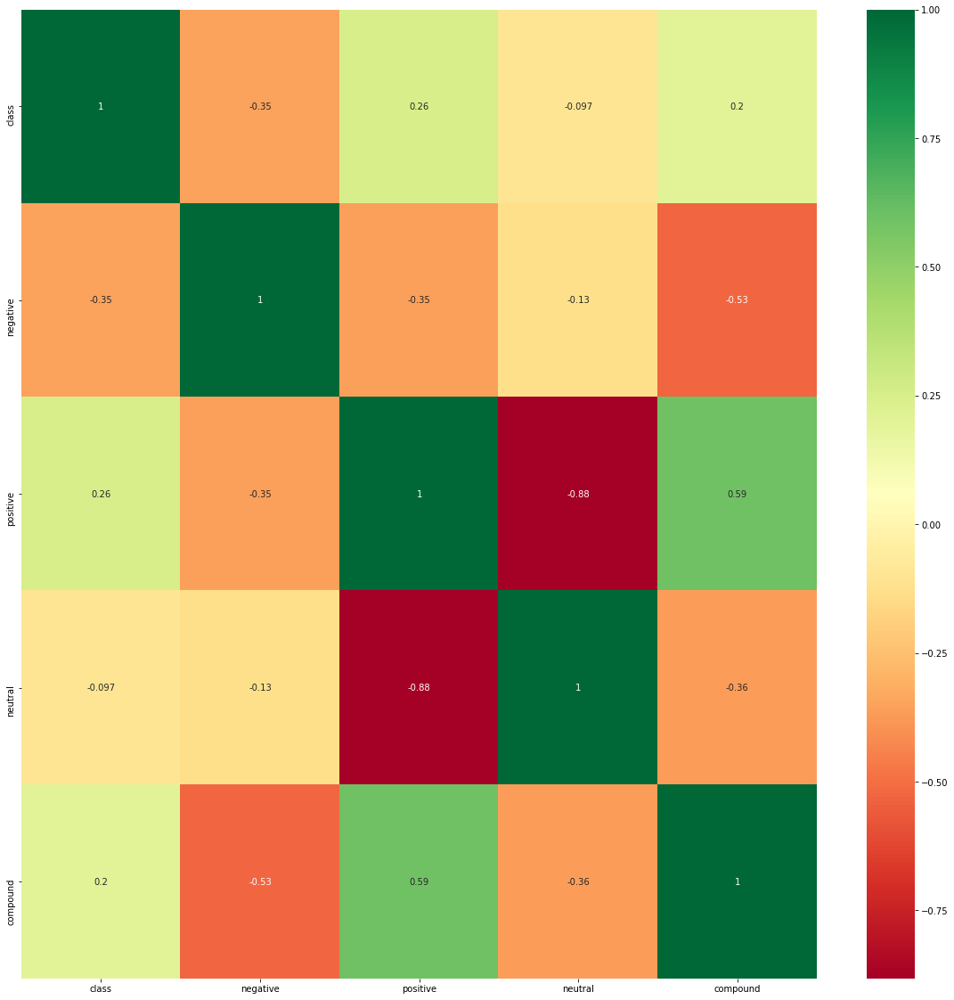

In [ ]:
sentiments = data[['class','negative','positive', 'neutral','compound']]
#get correlations
corrmat = sentiments.corr()
top_corr_features = corrmat.index
plt.figure(figsize=(20,20))
#plot heat map
g=sns.heatmap(sentiments[top_corr_features].corr(),annot=True,cmap="RdYlGn")

### Model Hypertuning

In [ ]:
# Run GridSearchCV on LinearSVC to tune hyperparameters
lsvc_grid = {'clf__penalty': ['l1','l2'],
                  'clf__dual': [False],
                  'clf__C': [0.2,0.3,0.4,0.5],
                  'clf__fit_intercept': [True, False],
                  'clf__class_weight' : [None, "balanced"],
                  'clf__max_iter' : [5000]}
lsvc_best_score, lsvc_best_params = grid_search_fit(X,y,LinearSVC(),lsvc_grid)

In [ ]:
# best individual LinearSVC
f1_macro, model = cross_validation_test(X,y,LinearSVC(dual=False,penalty='l1',fit_intercept=True, C=0.4, max_iter=6000,class_weight="balanced"))

In [ ]:
# Run GridSearchCV on LogisiticRegression to get a sense of what hyperparameters are best
logistic_grid = {'clf__solver':['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
                 'clf__C':[0.1, 1, 10, 20, 100],
                  'clf__max_iter':[2000],
                 'clf__class_weight':['balanced']}
lr_best_score, lr_best_params = grid_search_fit(X,y,LogisticRegression(),logistic_grid)

In [ ]:
# best individual LogisiticRegression
f1_macro, model = cross_validation_test(X,y,LogisticRegression(C=10,class_weight='balanced',max_iter=2000))

#### Ensemble Approaches

In [ ]:
# Run GridSearchCV on RandomForestClassifier to get a sense of what hyperparameters are best
rf_grid = {'clf__bootstrap': [True, False],
          'clf__max_depth': [10, 50, 100, None],
          'clf__max_features': ['sqrt'],
          'clf__n_estimators': [100, 200, 400]}
rf_grid = {'clf__max_features': ['sqrt'],
          'clf__n_estimators': [10, 100, 200]}
rf_best_score, rf_best_params = grid_search_fit(X,y,RandomForestClassifier(),rf_grid)}

In [ ]:
# best individual RandomForestClassifier
f1_macro, model = cross_validation_test(X,y,RandomForestClassifier(n_estimators=200,max_features='sqrt'))

In [ ]:
# AdaBoostClassifier with (deafult) Decision Tree
f1_macro, model = cross_validation_test(X, y,AdaBoostClassifier())

In [ ]:
# AdaBoostClassifier with our best RandomForestClassifier
f1_macro, model = cross_validation_test(X,y, AdaBoostClassifier(base_estimator=RandomForestClassifier(max_features='sqrt')))

In [ ]:
# Combine LinearSVC + LogisiticRegression in VotingClassifier
estimator_list = [('log',LogisticRegression(C=10,class_weight='balanced',max_iter=2000)),
                  ("lsvc", CalibratedClassifierCV(LinearSVC(dual=False,penalty='l1',fit_intercept=True, C=0.4, max_iter=6000,class_weight="balanced")))]
f1_macro, model = voting_fit(X,y,estimator_list) 

## Fit full model

In [ ]:
X_norm, norm = normalize(X, return_norm=True)
model_norm = train_full_model(X_norm,y, LinearSVC(dual=False,penalty='l1',fit_intercept=True, C=0.4, max_iter=6000,class_weight="balanced"))
model = train_full_model(X,y, LinearSVC(dual=False,penalty='l1',fit_intercept=True, C=0.4, max_iter=6000,class_weight="balanced")) 

['./model2.joblib']

## Generate Predictions

In [ ]:
def get_test_tfidf_table(pred_data):
    if 'text' in pred_data.columns: 
        # When data include text also
        text =  np.array(pred_data.text)
        vectorizer = pickle.load(open("vectorizer.pickle","rb"))
        vectors = vectorizer.transform(text)
        feature_names = vectorizer.get_feature_names()
        dense = vectors.todense()
        denselist = dense.tolist()
        tfidf_table = pd.DataFrame(denselist, columns=feature_names)
        return tfidf_table

# Conversion from Pandas row to array of arrays
def get_X_test_arr(df):
    rows = []
    for index, row in df.iterrows():
        rows.append(row.values)
    return rows    

def predictions(X_test,trained_model):
    # get predictions for trained model based on test set:
    # Conversion from Pandas row to array of arrays
    X_test_arr = get_X_test_arr(X_test)
    # Predictions from model
    y_pred = trained_model.predict(X_test_arr)
    return y_pred

pred = pd.read_json('temp.json').fillna("") # import data (PATH NOTE)
text_pred = pred[['reviewText_summary','asin']].rename(columns={'reviewText_summary':'text'}) # table with combined review+summary text per feature

X_pred = get_test_tfidf_table(text_pred)

X_pred['negative2'] = pred['negative']
X_pred['positive2'] = pred['positive'].apply(lambda x: x * -1)
X_pred['mispelledWords'] = pred['numOfMisspelledWords']
X_pred['percentageOfVerified'] = pred['percentageOfVerified'].apply(lambda x: x * -0.5)
X_pred = X_pred.drop(labels='class', axis=1)

test_set_y_pred = predictions(X_pred,model)
test_set_y_pred_table = pd.DataFrame({'asin': text_pred.asin, 'preds': test_set_y_pred})
test_set_y_pred_table.to_csv('predictions.csv', index=False)

model = joblib.load(open("model3.joblib","rb"))
test_set_y_pred = predictions(X_pred,model)
test_set_y_pred_table = pd.DataFrame({'asin': final_testing_set.asin, 'preds': test_set_y_pred})
test_set_y_pred_table.to_csv('predictions.csv', index=False)

# Depreciated 
## (Used for Deliverable 3, kept for graders to reference)

### Individual Train/Test Splitting (No Cross-Validation)

In [ ]:
# split data into training and test set (used for )
def split_data(tfidf_table,test_size):
    X_train, X_test, y_train, y_test = train_test_split(tfidf_table.drop('class',axis=1), tfidf_table['class'], test_size = test_size)
    return [X_train, X_test, y_train, y_test]

# train final model
def train_model(X_train,y_train,model_function):
    model = model_function(max_iter=2000, class_weight='balanced')
    return model.fit(X_train,y_train)

# Conversion from Pandas row to array of arrays
def get_X_test_arr(df):
    rows = []
    for index, row in df.iterrows():
        rows.append(row.values)
    return rows    

def predictions(X_test,trained_model):
    # get predictions for trained model based on test set:
    # Conversion from Pandas row to array of arrays
    X_test_arr = get_X_test_arr(X_test)
    # Predictions from model
    y_pred = trained_model.predict(X_test_arr)
    return y_pred

def train_and_make_predictions(X_train,y_train, X_test,model_function):
# train the model and make predictions - helper function for compute
    model = train_model(X_train,y_train,model_function)
    pred = predictions(X_test,model)
    return pred, model
    
def tfidf_and_split(data, numFeatures, ngram_max,):
# create a tfidf table and split it to get the train/test sets
    data_asin = np.array(data['asin'])
    data.drop('asin',axis=1);
    tfidf_table = get_tfidf_table(data, numFeatures,ngram_max) # keep track of asin values for later # drop asin because not a feature we want to fit on
    tfidf_table ['asin'] = pd.Series(data_asin) # get tfidf table
    split_data_tables = split_data(tfidf_table,0.2)
    return split_data_tables

def compute(data,model_function):
# compute brings all of the above functions together 
    if type(data) == list: 
        asin_test = np.array(data[1].asin)
        data[0].drop('asin',inplace=True,axis=1)
        data[1].drop('asin',inplace=True,axis=1) # get rid of asin
        y_pred, model = train_and_make_predictions(data[0],data[2],data[1],model_function) # train model
        y_true = np.array(data[3])  
        table = pd.DataFrame({'asin': asin_test,'True Value': y_true, 'Model Prediction': y_pred})
        return table, y_true, y_pred,  model
    else: # For sentiments only
        sp = split_data(data,0.2)
        asin_test = np.array(sp[1].asin)
        sp[0].drop('asin',inplace=True,axis=1)
        sp[1].drop('asin',inplace=True,axis=1)
        y_pred, model = train_and_make_predictions(sp[0],sp[2],sp[1],model_function)
        y_true = np.array(sp[3])
        table = pd.DataFrame({'asin': asin_test,'True Value': y_true, 'Model Prediction': y_pred})
        return table,y_true, y_pred, model

# Metrics

# Get f1, AUC and accuracy scores for individual test
def get_metrics(y_test,y_pred):
    print("F1: " +  repr(f1_score(y_test,y_pred,average="macro")), end="\n") 
    print("AUC: " + repr(roc_auc_score(y_test,y_pred,average='micro')), end="\n") 
    print("Accuracy: " + repr(accuracy_score(y_test,y_pred)), end="\n") 

# show prediction table for individual test
def show_true_pred_table(y_test, y_pred):
    table = pd.DataFrame({'True Value': y_test, 'Model Prediction': y_pred})

# show stats for specific test set
def show_test_stats(X_test, y_test, model):
    print("Evaluation on test set:\n")
    y_pred = predictions(X_test,model)
    print("Table of predictions:\n")
    show_true_pred_table(y_test, y_pred)
    print("Test metrics:\n")
    get_metrics(y_test,y_pred)

# Confusion matrix
def graph_confusion_matrix(y_true, y_pred):
    cm = confusion_matrix(y_true, y_pred)
    plt.clf()
    plt.imshow(cm, interpolation='nearest', cmap=plt.cm.Wistia)
    classNames = ['Negative','Positive']
    plt.title('Confusion Matrix')
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    tick_marks = np.arange(len(classNames))
    plt.xticks(tick_marks, classNames, rotation=45)
    plt.yticks(tick_marks, classNames)
    s = [['TN','FP'], ['FN', 'TP']]
    for i in range(2):
        for j in range(2):
            plt.text(j,i, str(s[i][j])+" = "+str(cm[i][j]))
    plt.show()

## Data Analysis (No need to run any cells here)

<AxesSubplot:title={'center':' Frequency vs Mean'}, ylabel='Frequency'>

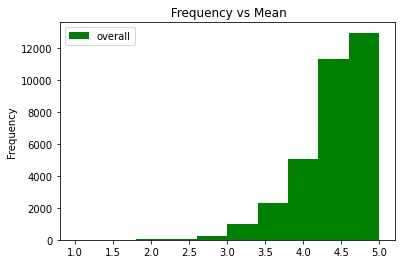

In [ ]:
data[['overall']].plot.hist(label="Mean Rating" ,color="green", title=" Frequency vs Mean")

<AxesSubplot:title={'center':' Positive Sentiment vs Mean Rating '}, xlabel='overall', ylabel='positive'>

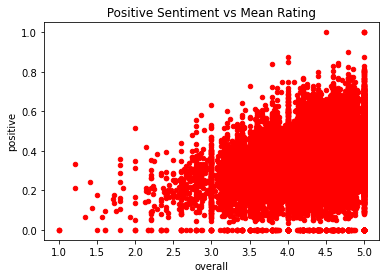

In [ ]:
data[['positive','overall']].plot.scatter(x="overall",y="positive", color="red", title=" Positive Sentiment vs Mean Rating ")

<AxesSubplot:title={'center':'Mean Rating vs Negative Sentiment'}, xlabel='overall', ylabel='negative'>

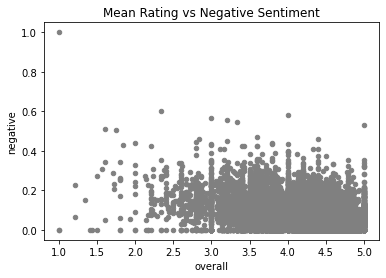

In [ ]:
data[['negative','overall']].plot.scatter(x="overall",y="negative", color="grey", title="Mean Rating vs Negative Sentiment")

<AxesSubplot:title={'center':'Number Of Reviews vs Mean Rating'}, xlabel='overall', ylabel='numberOfReviews'>

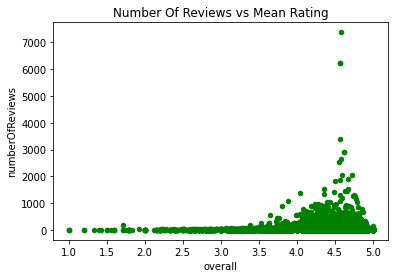

In [ ]:
data[['numberOfReviews','overall']].plot.scatter(x="overall",y="numberOfReviews", color="green", title="Number Of Reviews vs Mean Rating")

<AxesSubplot:title={'center':'Negative sentiment vs Positive sentiment'}, xlabel='positive', ylabel='negative'>

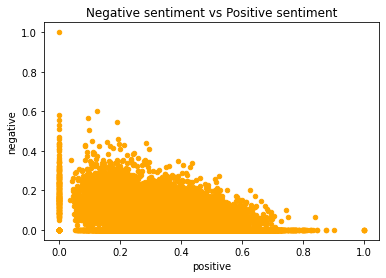

In [ ]:
data[['positive','negative']].plot.scatter(x="positive",y="negative", color="orange" ,title="Negative sentiment vs Positive sentiment")

<AxesSubplot:title={'center':'Neutral sentiment vs Positive sentiment'}, xlabel='neutral', ylabel='positive'>

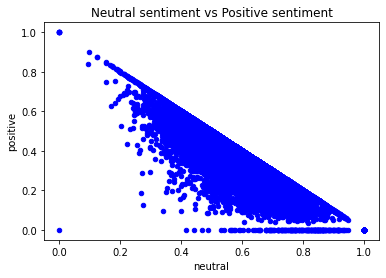

In [ ]:
data[['positive','neutral']].plot.scatter(x="neutral",y="positive", color="blue", title="Neutral sentiment vs Positive sentiment")

<AxesSubplot:title={'center':'Negative sentiment vs Neutral sentiment'}, xlabel='neutral', ylabel='negative'>

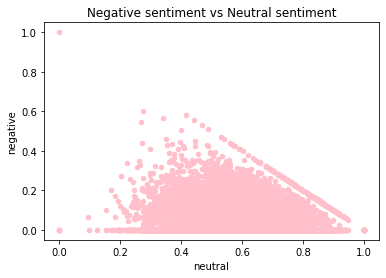

In [ ]:
data[['negative','neutral']].plot.scatter(x="neutral",y="negative", color="pink", title="Negative sentiment vs Neutral sentiment")

<AxesSubplot:title={'center':'Number Of Reviews vs Negative Sentiment'}, xlabel='negative', ylabel='numberOfReviews'>

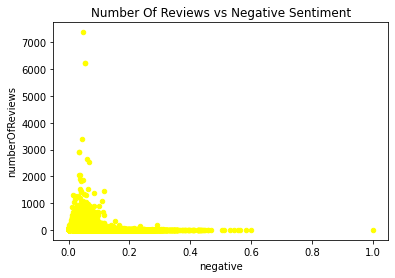

In [ ]:
# The higher the number of reviews, the lower the negative sentiment
data[['negative','numberOfReviews']].plot.scatter(x="negative",y="numberOfReviews", color="yellow", title="Number Of Reviews vs Negative Sentiment")

<AxesSubplot:title={'center':'Number Of Reviews vs Positive Sentiment'}, xlabel='positive', ylabel='numberOfReviews'>

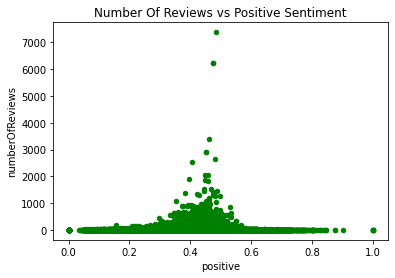

In [ ]:
data[['positive','numberOfReviews']].plot.scatter(x="positive",y="numberOfReviews", color="green", title="Number Of Reviews vs Positive Sentiment")

In [ ]:
class_0 = data.query('overall > 4.4')
print("Number of products in awesome class:")
print(data.query('overall > 4.4').shape[0])

Number of products in awesome class:
18608


In [ ]:
class_1 = data.query('overall < 4.4')
print("Number of products in Not Awesome class:")
print(data.query('overall < 4.4').shape[0])

Number of products in Not Awesome class:
13678


In [ ]:
print("Mean rating:")
np.mean(data.overall)

Mean rating:


4.394221723112467

In [ ]:
print("Median rating:")
np.median(data.overall)

Median rating:


4.4912280702

In [ ]:
print("Number of reviews per product mean:")
np.mean(data.numberOfReviews)

Number of reviews per product mean:


27.87642182962246

In [ ]:
print("Number of reviews per product median:")
np.median(data.numberOfReviews)

Number of reviews per product median:


10.0

## Create data sets (NOTE: Run all cells with datasets you want to analyze, feel free to add more!)

In [ ]:
# Sentiments only
dataset1 = queried_data[['negative','neutral','positive','class','asin']]
pred_dataset1 = queried_pred[['negative','neutral','positive','asin']]

In [ ]:
# Summary only
dataset2 = queried_data[['summary','class','asin']].rename(columns={'summary':'text'})
pred_dataset2 = queried_pred[['summary','asin']].rename(columns={'summary':'text'})

In [ ]:
# Reviews only
dataset3 = queried_data[['reviewText','class','asin']].rename(columns={'reviewText':'text'})
pred_dataset3 = queried_pred[['reviewText','asin']].rename(columns={'reviewText':'text'})

In [ ]:
# Sentiments + Summary
dataset4 = queried_data[['negative','neutral','positive','summary','class','asin']].rename(columns={'summary':'text'})
pred_dataset4 = queried_pred[['negative','neutral','positive','summary','asin']].rename(columns={'summary':'text'})

In [ ]:
# Sentiments + Reviews
dataset5 = queried_data[['negative','neutral','positive','reviewText','class','asin']].rename(columns={'reviewText':'text'})
pred_dataset5 = queried_pred[['negative','neutral','positive','reviewText','asin']].rename(columns={'reviewText':'text'})

In [ ]:
# Summary + Reviews
dataset6 = queried_data[['reviewText_summary','class','asin']].rename(columns={'reviewText_summary':'text'})
pred_dataset6 = queried_pred[['reviewText_summary','asin']].rename(columns={'reviewText_summary':'text'})

In [ ]:
# Sentiments + Summary + Reviews
dataset7 = queried_data[['negative','neutral','positive','reviewText_summary','class','asin']].rename(columns={'reviewText_summary':'text'})
pred_dataset7 = queried_pred[['negative','neutral','positive','reviewText_summary','asin']].rename(columns={'reviewText_summary':'text'})

In [ ]:
# (Stemmend Sentiments + Summary) + Reviews
dataset8 = queried_data[['negative','neutral','positive','stemmed_reviewText_summary','class','asin']].rename(columns={'stemmed_reviewText_summary':'text'})
#pred_dataset8 = queried_pred[['negative','neutral','positive','stemmed_reviewText_summary','asin']].rename(columns={'stemmed_reviewText_summary':'text'})

## Generate Predictions with ensemble method

In [ ]:
# Grid Search to find best settings for LogisticRegression
param_grid = {'solver': ['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'],
              'C': [0.01, 0.1, 1, 10],
              'max_iter' : [2000]}
# 'penalty': ['none', 'l1', 'l2', 'elasticnet']

lr_best_score, lr_best_params = grid_search_fit(dataset7, LogisticRegression(), param_grid, maxFeatures,ngram,SMOTE_on=False)
print(lr_best_score)
print(lr_best_params)

NameError: ignored

In [ ]:
# Grid Search to find best settings for RandomForest
param_grid = {'max_features': ['sqrt', 'log2'],
              'n_estimators': [10, 100, 200]}

rf_best_score, rf_best_params = grid_search_fit(dataset7, RandomForestClassifier(), param_grid, maxFeatures,ngram,SMOTE_on=False)
print(rf_best_score)
print(rf_best_params)

Fitting 10 folds for each of 6 candidates, totalling 60 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed: 22.6min
[Parallel(n_jobs=-1)]: Done  60 out of  60 | elapsed: 29.1min finished


0.7540720803051564
{'max_features': 'sqrt', 'n_estimators': 200}


## Logistic Regression - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,LogisticRegression,maxFeatures,ngram,SMOTE_on=True)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.67 (+/- 0.03)
F1: 0.72 (+/- 0.01)
AUC: 0.73 (+/- 0.03)
Accuracy: 0.68 (+/- 0.02)


### Dataset2 (Summary only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset2,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset2, pred_dataset2)

NameError: ignored

### Dataset3 (Reviews only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset3,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset3, pred_dataset3)

### Dataset4 (Sentiments + Summary)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset4,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset4, pred_dataset4)

### Dataset5 (Sentiments + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset5,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset5, pred_dataset5)

### Dataset6 (Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset6,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset6, pred_dataset6)

### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset7,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

#### Individual Test (Show Confusion Matrix)

In [ ]:
table, y_true7,y_pred7, model7  = compute(tfidf_and_split(dataset7,maxFeatures,ngram),LogisticRegression)
graph_confusion_matrix(y_true7, y_pred7)
get_metrics(y_true7, y_pred7)

### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,LogisticRegression,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

#### Individual Test (Show Confusion Matrix)

In [ ]:
table, y_true8,y_pred8, model8  = compute(tfidf_and_split(dataset8,maxFeatures,ngram),LogisticRegression)
graph_confusion_matrix(y_true8, y_pred8)
get_metrics(y_true8, y_pred8)

## GaussianNB - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,GaussianNB,maxFeatures,ngram,SMOTE_on=True)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.65 (+/- 0.01)
F1: 0.73 (+/- 0.06)
AUC: 0.72 (+/- 0.02)
Accuracy: 0.67 (+/- 0.02)


/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)


### Dataset2 (Summary only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset2,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset2, pred_dataset2)

NameError: ignored

### Dataset3 (Reviews only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset3,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset3, pred_dataset3)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.70 (+/- 0.06)
AUC: 0.73 (+/- 0.03)
Accuracy: 0.68 (+/- 0.04)


### Dataset4 (Sentiments + Summary)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset4,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset4, pred_dataset4)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.70 (+/- 0.05)
AUC: 0.72 (+/- 0.04)
Accuracy: 0.68 (+/- 0.04)


### Dataset5 (Sentiments + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset5,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset5, pred_dataset5)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.70 (+/- 0.06)
AUC: 0.73 (+/- 0.03)
Accuracy: 0.68 (+/- 0.04)


### Dataset6 (Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset6,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset6, pred_dataset6)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.72 (+/- 0.06)
AUC: 0.74 (+/- 0.02)
Accuracy: 0.69 (+/- 0.04)


### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset7,MultinomialNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.


Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.70 (+/- 0.06)
F1: 0.78 (+/- 0.03)
AUC: 0.80 (+/- 0.06)
Accuracy: 0.72 (+/- 0.05)


[Parallel(n_jobs=-1)]: Done  10 out of  10 | elapsed:   12.6s finished


### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,GaussianNB,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.71 (+/- 0.06)
AUC: 0.74 (+/- 0.02)
Accuracy: 0.69 (+/- 0.03)


## K-Nearest Neighbors - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,KNeighborsClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.69 (+/- 0.01)
AUC: 0.66 (+/- 0.02)
Accuracy: 0.64 (+/- 0.01)


### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset7,KNeighborsClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,KNeighborsClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

## Decision Trees - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,DecisionTreeClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.60 (+/- 0.02)
F1: 0.68 (+/- 0.05)
AUC: 0.58 (+/- 0.02)
Accuracy: 0.62 (+/- 0.03)


### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset7,DecisionTreeClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.67 (+/- 0.06)
AUC: 0.62 (+/- 0.04)
Accuracy: 0.63 (+/- 0.05)


### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,DecisionTreeClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.66 (+/- 0.06)
AUC: 0.61 (+/- 0.04)
Accuracy: 0.61 (+/- 0.05)


In [ ]:
from sklearn.ensemble import AdaBoostClassifier
mean_f1, model_func = cross_validation_fit(dataset1,AdaBoostClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset1)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.67 (+/- 0.03)
F1: 0.74 (+/- 0.03)
AUC: 0.73 (+/- 0.06)
Accuracy: 0.68 (+/- 0.03)


## Random Forest - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,RandomForestClassifier,maxFeatures,ngram,SMOTE_on=True)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarning)
/usr/local/lib/python3.6/dist-packages/sklearn/utils/deprecation.py:87: FutureWarning: Function safe_indexing is deprecated; safe_indexing is deprecated in version 0.22 and will be removed in version 0.24.
  warnings.warn(msg, category=FutureWarni

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.63 (+/- 0.02)
F1: 0.69 (+/- 0.02)
AUC: 0.66 (+/- 0.01)
Accuracy: 0.64 (+/- 0.02)


### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset7,RandomForestClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1 macro: 0.75 (+/- 0.04)
F1: 0.80 (+/- 0.03)
AUC: 0.84 (+/- 0.06)
Accuracy: 0.76 (+/- 0.04)


### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,RandomForestClassifier,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

In [ ]:
from sklearn.model_selection import RandomizedSearchCV

# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start = 200, stop = 1000, num = 10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num = 11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
               'max_features': max_features,
               'max_depth': max_depth,
               'min_samples_split': min_samples_split,
               'min_samples_leaf': min_samples_leaf,
               'bootstrap': bootstrap}



In [ ]:
random_search_fit(dataset7,LinearSVC,2000,2,SMOTE_on=False)

Fitting 10 folds for each of 20 candidates, totalling 200 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  7.7min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 24.3min
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed: 27.5min finished


0.7891257255667983
{'penalty': 'l1', 'max_iter': 1000, 'loss': 'squared_hinge', 'intercept_scaling': 1.0, 'fit_intercept': False, 'dual': False, 'class_weight': None, 'C': 0.25}


0.7891257255667983

In [ ]:
random_search_fit(dataset7,LinearSVC,2000,2,SMOTE_on=False)

Fitting 10 folds for each of 20 candidates, totalling 200 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  1.5min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 17.7min
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed: 19.2min finished


0.7891889973598853
{'penalty': 'l1', 'max_iter': 1500, 'loss': 'squared_hinge', 'intercept_scaling': 1.0, 'fit_intercept': False, 'dual': False, 'class_weight': None, 'C': 0.25}


0.7891889973598853

In [ ]:
random_search_fit(dataset7,LinearSVC,2000,2,SMOTE_on=False)

Fitting 10 folds for each of 20 candidates, totalling 200 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  1.7min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed: 17.6min
[Parallel(n_jobs=-1)]: Done 200 out of 200 | elapsed: 18.9min finished


0.8260730769308255
{'penalty': 'l1', 'max_iter': 1500, 'loss': 'squared_hinge', 'intercept_scaling': 1.0, 'fit_intercept': False, 'dual': False, 'class_weight': None, 'C': 0.25}


0.8260730769308255

In [ ]:
grid_search_fit_LinearSVM(dataset7,2000,2,SMOTE_on=False)

Fitting 10 folds for each of 48 candidates, totalling 480 fits


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 2 concurrent workers.
[Parallel(n_jobs=-1)]: Done  37 tasks      | elapsed:  2.0min
[Parallel(n_jobs=-1)]: Done 158 tasks      | elapsed:  8.6min
[Parallel(n_jobs=-1)]: Done 361 tasks      | elapsed: 33.4min
[Parallel(n_jobs=-1)]: Done 480 out of 480 | elapsed: 52.9min finished


0.7908170058682853
{'C': 0.25, 'class_weight': 'balanced', 'dual': False, 'fit_intercept': True, 'max_iter': 1000, 'penalty': 'l1'}


/usr/local/lib/python3.6/dist-packages/sklearn/svm/_base.py:947: ConvergenceWarning: Liblinear failed to converge, increase the number of iterations.
  "the number of iterations.", ConvergenceWarning)


0.7908170058682853

## Support Vector Machines (SVC) - Cross Validation

### Dataset1 (Sentiments Only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset1,LinearSVC,maxFeatures,ngram,SMOTE_on = True)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset1, pred_dataset1)

ValueError: ignored

### Dataset2 (Summary only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset2,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset2, pred_dataset2)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.79 (+/- 0.05)
AUC: 0.82 (+/- 0.08)
Accuracy: 0.75 (+/- 0.05)


### Dataset3 (Reviews only)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset3,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset3, pred_dataset3)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.80 (+/- 0.06)
AUC: 0.84 (+/- 0.07)
Accuracy: 0.76 (+/- 0.06)


### Dataset4 (Sentiments + Summary)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset4,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset4, pred_dataset4)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.79 (+/- 0.05)
AUC: 0.82 (+/- 0.08)
Accuracy: 0.75 (+/- 0.05)


### Dataset5 (Sentiments + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset5,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset5, pred_dataset5)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.80 (+/- 0.06)
AUC: 0.84 (+/- 0.07)
Accuracy: 0.76 (+/- 0.06)


### Dataset6 (Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset6,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset6, pred_dataset6)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.82 (+/- 0.05)
AUC: 0.86 (+/- 0.06)
Accuracy: 0.79 (+/- 0.05)


#### Individual Test (Show Confusion Matrix)

In [ ]:
table, y_true6,y_pred6, model6  = compute(tfidf_and_split(dataset6,maxFeatures,ngram),LinearSVC)
graph_confusion_matrix(y_true6, y_pred6)
get_metrics(y_true6, y_pred6)

NameError: name 'dataset6' is not defined

### Dataset7 (Sentiments + Summary + Reviews)

In [ ]:


mean_f1, model_func = cross_validation_fit(dataset7,CalibratedClassifierCV(LinearSVC(dual=False, fit_intercept=True, C=0.25,class_weight="balanced",max_iter=2000)),maxFeatures,ngram,SMOTE_on=False)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset7, pred_dataset7)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  ................................................................
[CV] ................................................. , total=  11.0s
[CV]  ................................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   11.0s remaining:    0.0s


[CV] ................................................. , total=  11.8s
[CV]  ................................................................
[CV] ................................................. , total=  12.4s
[CV]  ................................................................
[CV] ................................................. , total=  12.4s
[CV]  ................................................................
[CV] ................................................. , total=  13.0s
[CV]  ................................................................
[CV] ................................................. , total=  13.0s
[CV]  ................................................................
[CV] ................................................. , total=  13.2s
[CV]  ................................................................
[CV] ................................................. , total=  13.3s
[CV]  ................................................................
[CV] .

[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:  2.1min finished


In [ ]:
maxFeatures = 2000
mean_f1, model_func = voting_fit(dataset7,maxFeatures,ngram,SMOTE_on=False)

[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.


[CV]  ................................................................
[CV] ................................................. , total=  36.8s
[CV]  ................................................................


[Parallel(n_jobs=1)]: Done   1 out of   1 | elapsed:   36.8s remaining:    0.0s


[CV] ................................................. , total=  37.0s
[CV]  ................................................................
[CV] ................................................. , total=  36.9s
[CV]  ................................................................
[CV] ................................................. , total=  38.6s
[CV]  ................................................................
[CV] ................................................. , total=  37.5s
[CV]  ................................................................
[CV] ................................................. , total=  37.6s
[CV]  ................................................................
[CV] ................................................. , total=  39.4s
[CV]  ................................................................
[CV] ................................................. , total=  38.6s
[CV]  ................................................................
[CV] .

[Parallel(n_jobs=1)]: Done  10 out of  10 | elapsed:  6.3min finished


In [ ]:
print(mean_f1)

0.7896500404531056


#### Individual Test (Show Confusion Matrix)

In [ ]:
table, y_true7,y_pred7, model7  = compute(tfidf_and_split(dataset7,maxFeatures,ngram),LinearSVC)
graph_confusion_matrix(y_true7, y_pred7)
get_metrics(y_true7, y_pred7)

### Dataset8 (Stemmend Sentiments + Summary + Reviews)

In [ ]:
mean_f1, model_func = cross_validation_fit(dataset8,LinearSVC,maxFeatures,ngram)
if best_f1 < mean_f1:
    best_f1 = mean_f1
    best_model = (model_func, dataset8, pred_dataset8)

Cross validation metrics (5 folds, 95% Confidence Intervals):

F1: 0.81 (+/- 0.05)
AUC: 0.85 (+/- 0.06)
Accuracy: 0.78 (+/- 0.05)


## Determine best model based on highest f1 score (NOTE: Must have one run cross-validation cell)

In [ ]:
print("The highest mean f1 score achieved was " + str(best_f1) + " by " + str(best_model[0]) + ".")

## Fit the best model (NOTE: Must have one run cross-validation cell)

In [ ]:
model = train_full_model(best_model[1],best_model[0],maxFeatures,ngram)

## Make test predictions (NOTE: Work in progress!)